# Libraries

In [335]:
# PROCCESSING
import numpy as np
import pandas as pd

# PATH
import os

# AUDIO FILES
from scipy.io import wavfile
from IPython.display import Audio
import librosa
import noisereduce as nr

# PLOTING
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go

# SIGNAL PROCESSING
from scipy import signal, fft

# SPEECH PROCESSING
import python_speech_features as sf

# MACHINE LEARNING
from sklearn.svm import LinearSVC, SVC
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, matthews_corrcoef
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, QuantileTransformer
from sklearn.decomposition import PCA

# Local functions
from mfcc import get_mfcc, deltas, filterbank, freq_bins, freq_to_mel, mel_to_freq

In [336]:
import warnings
from scipy.io.wavfile import WavFileWarning

# Ignore WavFileWarning
#warnings.simplefilter('ignore', WavFileWarning)

# 0. Import data

In [337]:
def search_wav_files(path):
    files = []
    for root, subdirs, file_list in os.walk(path):
        for file in file_list:
            if '.wav' in file:  # Check if 'wav_arrayMic' is in the path
                files.append(os.path.join(root, file))
    return files

def read_error_file(path):
    # read the errors file
    errors = pd.read_excel(f'{path}ERRORS.xls')

    # remove empty rows
    errors = errors.dropna(subset=['Subject ID','Session'])

    # remove rows with values different from nan in "Channel"
    errors = errors[errors['Channel'].isnull()]
    errors = errors.drop(columns=['Channel'])

    # convert numbers in 'Trial #' to 'xxxx' format with zeros at the beggining to match wav filenames
    errors['Trial #'] = errors['Trial #'].apply(lambda x: f'{int(x):04d}')

    # create a list with the names of the files to be removed
    files_to_remove = errors.apply(lambda x: f"{path}{x['Folder']}{x['Subject ID']}/{x['Session']}/wav_headMic/{x['Trial #']}.wav", axis=1).values

    return files_to_remove

def keep_only_headMic(files): # keep only the files that have 'headMic' in the path
    return [file for file in files if 'headMic' in file]

def remove_files_from_list(files, files_to_remove): # remove the the entries from "files" that are in "files_to_remove"
    return [file for file in files if file not in files_to_remove]

def binary_label_files(files):
    df = pd.DataFrame(files, columns=['path'])
    df['label'] = df['path'].apply(lambda x: 0 if 'without' in x else 1)
    return df

def get_wav_duration(file):
    x, fx = librosa.load(file, sr=None)
    return len(x) / fx

def get_file_names(dataset_path):
    # check if there is already a file with the file names
    if os.path.exists(f'{dataset_path}files.txt'):
        with open(f'{dataset_path}files.txt', 'r') as f:
            files = f.read().splitlines()
    else:
        files = search_wav_files(dataset_path) # search WAV files in the dataset folder
        files = keep_only_headMic(files) 
    
        files_to_remove = read_error_file(dataset_path) # read the ERRORS.xls file and get the files to be removed
    
        files = remove_files_from_list(files, files_to_remove) # remove the files to be removed

    return files

In [338]:
dataset_path = 'datasets/TORGO/'

if not os.path.exists(f'{dataset_path}features.csv'):
    files = get_file_names(dataset_path)

    # save the list of files to a file
    with open(f'{dataset_path}files.txt', 'w') as f:
        for file in files:
            f.write(f'{file}\n')

    # label the files
    df = binary_label_files(files)

    # get the duration of the files
    df['duration'] = df['path'].apply(get_wav_duration)

    # order df by duration descending
    df = df.sort_values(by='duration', ascending=False)
else:
    df = pd.read_csv(f'{dataset_path}features.csv')

df.head(10)

,path,label,duration
2415,datasets/TORGO/females_with_dysarthria\F03\Ses...,1,193.828625
6457,datasets/TORGO/males_with_dysarthria\M01\Sessi...,1,179.943125
7000,datasets/TORGO/males_with_dysarthria\M03\Sessi...,1,43.155062
7046,datasets/TORGO/males_with_dysarthria\M03\Sessi...,1,41.810063
7156,datasets/TORGO/males_with_dysarthria\M03\Sessi...,1,41.085062
7304,datasets/TORGO/males_with_dysarthria\M03\Sessi...,1,40.490063
7720,datasets/TORGO/males_with_dysarthria\M05\Sessi...,1,25.315000
7503,datasets/TORGO/males_with_dysarthria\M04\Sessi...,1,23.590062
7676,datasets/TORGO/males_with_dysarthria\M04\Sessi...,1,23.175000
7701,datasets/TORGO/males_with_dysarthria\M05\Sessi...,1,20.850000


## 0.1 Sample duration filtering

In [339]:
# some files are too long or too short
df = df[df['duration'] < 10]
df = df[df['duration'] > 1]

df.reset_index(drop=True, inplace=True)

df.head(5)

,path,label,duration
0,datasets/TORGO/females_with_dysarthria\F03\Ses...,1,9.973250
1,datasets/TORGO/males_with_dysarthria\M05\Sessi...,1,9.965000
2,datasets/TORGO/males_with_dysarthria\M02\Sessi...,1,9.950062
3,datasets/TORGO/females_with_dysarthria\F04\Ses...,1,9.950000
4,datasets/TORGO/females_with_dysarthria\F03\Ses...,1,9.925062


## Class distribution

In [340]:
number_of_files = df.shape[0]

# pie plot of the label
fig = px.pie(df, names='label', title=f'Label distribution, Total files: {number_of_files}')
fig.update_layout(autosize=False, width=500, height=500)  # Adjust width and height as needed
fig.show()

In [341]:
# plot the duration column
fig = go.Figure()
fig.add_trace(go.Histogram(x=df['duration'], nbinsx=100))

# 1. Preprocessing

In [342]:
# Read file
wav_filename = df[df['label'] == 0]['path'].iloc[0]
x, fx = librosa.load(wav_filename, sr=None)

# Listen
Audio(x, rate=fx)

In [343]:
# get t[s]
t = np.arange(0, len(x)/fx, 1/fx)

# plot
fig = go.Figure()
fig.add_trace(go.Scatter(x=t, y=x, mode='lines'))
fig.update_layout(title=f'{wav_filename} fx={fx}', xaxis_title='Time [s]', yaxis_title='Amplitude')

## 1.1 Noise Reduction

### Short Time Fourier Transform (STFT)

The voice recordings are divided into small frames of length $N$ samples. After the division into short frames, the short-time Fourier transform (STFT) is applied to each short frame to convert the signal into the frequency domain from the time domain. For a given frame $x[n]$ of length $N$, the STFT is calculated using:

$$ X(k,m) = STFT(x[n]) = \sum_{n=0}^{N-1} x[n] \cdot w[n - mH] \cdot e^\frac{-2j}{N} $$

Where,
- $X(k,m)$ is the complex value of the kth frequency bin at frame $m$
- $w[n - mH]$ is the window function applied to the frame
- $H$ is the hop size
- $k$ ranges from 0 to $N-1$
- $m$ represents the frame index


#### Noise estimation

Now estimate the level of noise by computing the average for the magnitude spectrum of the noisy frames as $|N(k)|$. Then calculate the magnitude of the noisy version of the signal’s spectrum $|Y (k, m)|$ which is obtained from STFT.

#### Spectral Subtraction

Subtract the estimated noise spectrum from the noisy signal spectrum.

$$ |X_{clean}(k, m)| = \max(|Y(k, m)| - \alpha|N(k)|, 0) $$

Where,
- $|X_{clean}(k, m)|$ denotes the magnitude of the spectrum of the clean signal
- $\alpha$ is the scaling factor which is set to 1.9 to controlling the amount of noise reduction

#### Inverse STFT

Apply inverse STFT (ISTFT) using Eq. (3) to obtain the clean time-domain signal.

\begin{align*}
    X_{clean}[n] &= ISTFT(X_{clean}(k,m)) \\
    &= \sum_{m=0}^{M-1} (X_{clean}(k,m) \cdot e^\frac{j 2 \pi k n}{N} ) \cdot w'[n - mH]
\end{align*}

Where,
- $X_{clean}[n]$ is the cleared signal.
- $w'[n - mH]$ is the inverse window function.

In [344]:
# Hann window
milliseconds_in_window = 25 # Standard window size for speech processing
samples_in_window = int(milliseconds_in_window * fx / 1000)

w = signal.get_window(window='hann', Nx=samples_in_window)  

# Short Time Fourier Transform Class
STFT = signal.ShortTimeFFT(win=w, hop=int(samples_in_window/2), fs=fx, scale_to='magnitude')  

# Apply STFT
Sx = STFT.stft(x) # Sx.shape = (k, m); f = frequency bins , t = time frames

# Take the absolute value of Sx to get the magnitude
Sx_magnitude = np.abs(Sx)

# spectrogram plot
fig = go.Figure()
n = Sx_magnitude.shape[1] 
fig.add_trace(go.Heatmap(z=Sx_magnitude, x=STFT.t(n), y=STFT.f))
fig.update_layout(title=f'{wav_filename} fx={fx}', xaxis_title='Time [s]', yaxis_title='Frequency [Hz]')
fig.show()

# Amplitude/frequency plot
fig = go.Figure()
n = Sx_magnitude.shape[1]
fig.add_trace(go.Scatter(x=STFT.f, y=Sx_magnitude[:, n//2], mode='lines'))
fig.update_layout(title=f'{wav_filename} fx={fx}', xaxis_title='Frequency [Hz]', yaxis_title='Amplitude')
fig.show()

In [345]:
# Calculate the magnitude mean 
Sx_magnitude_mean = np.mean(Sx_magnitude, axis=1)
alpha = 1.9

# Clean the magnitude
Sx_magnitude_clean = np.maximum(Sx_magnitude - alpha * Sx_magnitude_mean[:, np.newaxis], 0)

# Spectrogram plot
fig = go.Figure()
fig.add_trace(go.Heatmap(z=Sx_magnitude_clean, x=STFT.t(n), y=STFT.f))
fig.update_layout(title=f'{wav_filename} fx={fx}', xaxis_title='Time [s]', yaxis_title='Frequency [Hz]')
fig.show()

# Amplitude/frequency plot
fig = go.Figure()
n = Sx_magnitude_clean.shape[1]
fig.add_trace(go.Scatter(x=STFT.f, y=Sx_magnitude_clean[:, n//2], mode='lines'))
fig.update_layout(title=f'{wav_filename} fx={fx}', xaxis_title='Frequency [Hz]', yaxis_title='Amplitude')
fig.show()

In [346]:
# Inverse STFT
x_clean = STFT.istft(Sx_magnitude_clean)

# Plot 
fig = go.Figure()
fig.add_trace(go.Scatter(x=t, y=x, mode='lines', name='Original'))
fig.add_trace(go.Scatter(x=t, y=x_clean, mode='lines', name='Clean'))
fig.update_layout(title=f'{wav_filename} fx={fx}', xaxis_title='Time [s]', yaxis_title='Amplitude')
fig.show()

In [347]:
# Listen
Audio(x_clean, rate=fx)

## noisereduce package

In [348]:
x_denoised = nr.reduce_noise(y=x, sr=fx)

In [349]:
# Plot 
fig = go.Figure()
fig.add_trace(go.Scatter(x=t, y=x, mode='lines', name='Original'))
fig.add_trace(go.Scatter(x=t, y=x_denoised, mode='lines', name='Clean'))
fig.update_layout(title=f'{wav_filename} fx={fx}', xaxis_title='Time [s]', yaxis_title='Amplitude')
fig.show()

In [350]:
Audio(x_denoised, rate=fx)

# 2. Feature Extraction

## 2.1 Mel Frequency Cepstral Coefficient (MFCC)

[Tutorial](http://www.practicalcryptography.com/miscellaneous/machine-learning/guide-mel-frequency-cepstral-coefficients-mfccs/)

The formula for converting from frequency to Mel Scale is:

$$M(f) = 1125 \ln(1 + f/700)$$

TO go from Mels back to frequency:

$$M^{-1}(m) = 700 (\exp(m/1125) - 1)$$

We start with a speech signal, we'll asume sampled at 16kHz.

### 1. Frame the signal

Frame the signal into 20-40 ms frames. 25ms is standard. This means the frame length for a 16kHz signal is 0.025*16000 = 400 samples. Frame step is usually something like 10ms (160 samples), which allows some overlap to the frames. The first 400 sample frame starts at sample 0, the next 400 sample frame starts at sample 160 etc. until the end of the speech file is reached. If the speech file does not divide into an even number of frames, pad it with zeros so that it does.

The next steps are applied to every single frame, one set of 12 MFCC coefficients is extracted for each frame. A short aside on notation: We call our time domain signal $s(n)$. Once it is framed we have $s_i(n)$ where $n$ ranger over the number of samples in each frame and $i$ ranges over the number of frames. When we calculate the complex Discrete Fourier Transform (DFT), we get $S_i(k)$ where $i$ denotes the frame number corresponding the the time-domain frame. $P_i(k)$ is then the power spectrum of frame $i$.

### 2. Perform Discrete Fourier Transform (DFT)

To take the DFT of the frame perform the following:

$$ S_i(k) = \sum_{n=1}^N s_i(n) h(n) e^{-2 j \pi k n / N} \qquad 1 \leq k \leq N $$

Where $h(n)$ is the $N$ sample long analysis window (ej. Hamming window), and $k$ is the length of the DFT. The periodogram-based power spectral estimate for the speech frame $s_i(n)$ is given by:

$$ P_i(k) = \frac{1}{N} |S_i(k)|^2 $$

This is called the Periodogram estimate of the power spectrum. We take the absolute value of the complex fourier transform, and square the result. We would generally perform a 512 point FFT and keep only the first 257 coefficients.

### 3. Compute the Mel-spaced filterbank. 

This is a set of 20-40 (26 is standard) triangular filters that we apply to the periodogram power spectral estimate from step 2. Our filterbank comes in the form of 26 vectors of length 257 (assuming the fft setting from step 20). Each vector is mostly zeros, but is non-zero for a certain section of the spectrum. **To calculate filterbank energies we multiply each filterbank with the power spectrum, then add up the coefficients**. Once this is performed we are left with 26 numbers that give us an indication of how much energy was in each filterbank.

#### Computing the Mel Filterbank

In this section the example will use 10 filterbanks because it is easier to display, in reality you would use 26-40 filterbanks.

First we have to choose a lower and upper frequency. Good values are 300Hz for the lower and 8000Hz for the upper frequency. Of course if the speech is sampled at 8000Hz our upper frequency is limited to 4000Hz. Then follow these steps:

1. Convert the upper and lower frequency to Mel scale. in our case 300Hz is 401.25 mels and 8000Hz is 2834.99 mels.

2. For this example we will do 10 filterbanks, for which we need 12 pointss. This means we need 10 additional points spaced linearly between 401.25 and 2834.99:

$$ m(i) = 401.25, 622.50, 843.75, 1065.00, 1286.25, 1507.50, 1728.74, 1949.99, 2171.24, 2392.49, 2613.74, 2834.99 $$

3. Now we convert these points back to frequency:

$$ h(i) = 300, 517.33, 781.90, 1103.97, 1496.04, 1973.32, 2554.33, 3261.62, 4122.63, 5170.76, 6446.70, 8000 $$

4. We don't have the frequency resolution required to put filters at the exact points calculated above, so we need to round those frequencies to the nearest FFT bin. This process does not affect the accuracy of the features. To convert the frequencies to fft bin numbers we need to know the FFT size and the sample rate.

    $$ f(i) = floor\left(\frac{(nfft+1) \cdot h(i)}{sample\_rate}\right) $$
    $$ f(i) = floor\left(\frac{513 \cdot h(i)}{16\text{kHz}}\right)  $$
    $$ f(i) = 9, 16,  25,   35,   47,   63,   81,  104,  132, 165,  206,  256 $$

    We can see that the final filterbank finishes at bin 256, which correspond to 8kHz with a 512 point FFT size.

5. Now we create our filterbanks. The first filterbank will start at the 1st point, reach its peak at the 2nd point, the return to zero at the 3rd point. The 2nd filterbank will start at the 2nd point, reach its peack at the 3rd, then be zero at the 4th etc. A formula for calculating these is as follows:

    $$
    H_m(k) = 
    \begin{cases}
    0 & k < f(m-1) \\
    \frac{k - f(m-1)}{f(m)-f(m-1)} & f(m-1) \leq k \leq f(m) \\
    \frac{f(m+1)-k}{f(m+1)-f(m)} & f(m) \leq k \leq f(m+1) \\
    0 & k > f(m+1)
    \end{cases}
    $$
    
    Where $M$ is the number of filters we want, and $f()$ is the list of $M+2$ Mel-spaced frequencies.

### 4. Take the log.

Take the log of each of the 26 energies from step 3. This leaves us with 26 log filterbank energies.

### 5. Compute the Discrete Cosine Transform (DCT).

Take the Discrete Cosine Transform (DCT) of the 26 log filterbank energies to give 26 cepstral coefficients. For ASR, only the lower 12-13 of the 26 coefficients are kept.

### The resulting features (12 numbers for each frame) are called Mel Frequency Cepstral Coefficients.

#### Deltas and Delta-Deltas.

Also known as differential and acceleration coefficients. The MFCC feature vector describes only the power spectral envelope of a single frame, but it seems like speech would also have information in the dynamics i.e. what are the trajectories of the MFCC coefficients over time. It turns out that calculating the MFCC trajectories and appending them to the original feature vector increases ASR performance by quite a bit (if we have 12 MFCC coefficients, we would also get 12 delta coefficients, which would combine to give a feature vector of length 24).

To calculate the delta coefficients, the following formula is used:

$$ d_t = \frac{\sum_{n=1}^N n \cdot (c_{t+n} - c_{t-n})}{2 \sum_{n=1}^N n^2} $$

Where $d_t$ is a delta coefficient, from frame $t$ computed in terms of the static coefficients $c_{t+N}$ to $c_{t-N}$. A typical value for $N$ is 2. Delta-Delta (Acceleration) coefficients are calculated in the same way, but using the delta coefficients instead of the static coefficients.


In [351]:
# ------- Step 1. Frame the signal and 2. Perform Fourier transform -------
# Hanning window
milliseconds_in_window = 25 # Standard window size for speech processing
samples_in_window = int(milliseconds_in_window * fx / 1000)
milliseconds_in_hop = 10 # Standard hop size for speech processing
samples_in_hop = int(milliseconds_in_hop * fx / 1000)

w = signal.get_window(window='hann', Nx=samples_in_window)

STFT = signal.ShortTimeFFT(win=w, hop=samples_in_hop, fs=fx, scale_to='magnitude',mfft=512)  
Sx = STFT.stft(x)

# Calculate Periodogram estimate of the power spectrum
Sx_power = (np.abs(Sx)**2) / samples_in_window

# --------------- Step 3. Compute the Mel Space Filterbank  ---------------
# Number of filters
n_filters = 26

# Lower and Upper frequency
lower_freq = 300
upper_freq = 8000

# Get the frequency bins
f_bins = freq_bins(lower_freq, upper_freq, n_filters, fx=fx, mfft=512)

# Filterbank
filterbank_ = filterbank(f_bins=f_bins, n_filters=n_filters, mfft=512)

# Plot
fig = go.Figure()
for i in range(n_filters):
    fig.add_trace(go.Scatter(x=STFT.f, y=filterbank_[i], mode='lines', name=f'Filterbank {i+1}'))
fig.update_layout(title='Mel Filterbank', xaxis_title='Frequency [Hz]', yaxis_title='Amplitude')
fig.show()

# Calculate the filterbank energy
filterbank_energies = np.dot(filterbank_, Sx_power)

# ---------------------- Step 4. Take the logarithm ----------------------
log_filterbank_energies = np.log(filterbank_energies)
filterbank_energies.shape

# ------------------------- Step 5. Take the DCT -------------------------
n_cepstral = 12
mfcc = fft.dct(log_filterbank_energies, type=2, axis=0, norm='ortho')[:n_cepstral]

In [352]:
# ---------- Extra Step: Calculate the Deltas and Delta-Deltas ---------

# Calculate the delta-deltas
delta = deltas(mfcc, window=2)
delta_delta = deltas(delta, window=2)

# Append the deltas and delta-deltas to the MFCC
mfcc = np.vstack([mfcc, delta, delta_delta])
mfcc.shape

(36, 961)

## Get MFCC function

### Own implementation

### python_speech_features implementation

In [353]:
def get_mfcc_from_library(x: np.ndarray,
                          fx: int,
                          window_len: int = 0.025,
                          window_step: int = 0.01,
                          n_filters: int = 26,
                          n_cepstral: int = 12,
                          mfft: int = 512,
                          deltas: bool = True,
                          ddeltas: bool = True) -> np.ndarray:
    '''
    Get the MFCC of a signal using python_speech_features

    Parameters
    ----------
    x: numpy array
        Signal
    fx: int
        Sampling frequency
    window_len : int
        Window length in seconds
    window_step : int
        Window step in seconds
    n_filters : int
        Number of filters
    n_cepstral : int
        Number of cepstral coefficients
    mfft : int
        Number of points in the FFT
    deltas : bool
        If True, calculate the deltas
    ddeltas : bool
        If True, calculate the delta-deltas

    Returns
    -------
    mfcc : numpy array
        MFCC of the signal
    '''
    # Get the MFCC
    mfcc = sf.mfcc(signal = x, 
                   samplerate = fx, 
                   winlen = window_len, 
                   winstep = window_step, 
                   numcep = n_cepstral, 
                   nfilt = n_filters, 
                   nfft = mfft, 
                   lowfreq = 0,
                   highfreq = 8000,
                   preemph = 0, 
                   ceplifter = 0, 
                   appendEnergy = False,
                   winfunc = lambda x: np.hanning(x)
    )
    
    # Calculate the deltas
    if deltas:
        delta = sf.delta(mfcc, 2)
        mfcc = np.hstack([mfcc, delta])

    # Calculate the delta-deltas
    if ddeltas:
        delta_delta = sf.delta(delta, 2)
        mfcc = np.hstack([mfcc, delta_delta])

    return mfcc.T

### librosa implementation

In [354]:
def get_mfcc_from_librosa(x: np.ndarray,
                          fx: int,
                          window_len: int = 0.025,
                          window_step: int = 0.01,
                          n_filters: int = 26,
                          n_cepstral: int = 12,
                          mfft: int = 512,
                          deltas: bool = True,
                          ddeltas: bool = True) -> np.ndarray:
    '''
    Get the MFCC of a signal using librosa

    Parameters
    ----------
    x: numpy array
        Signal
    fx: int
        Sampling frequency
    window_len : int
        Window length in seconds
    window_step : int
        Window step in seconds
    n_filters : int
        Number of filters
    n_cepstral : int
        Number of cepstral coefficients
    mfft : int
        Number of points in the FFT
    deltas : bool
        If True, calculate the deltas
    ddeltas : bool
        If True, calculate the delta-deltas

    Returns
    -------
    mfcc : numpy array
        MFCC of the signal
    '''
    # Check if the signal length is enough
    if len(x) < 512:
        x = librosa.util.fix_length(x, size=512)

    # Get the MFCC
    mfcc = librosa.feature.mfcc(y = x.astype(float), 
                                sr = fx, 
                                n_mfcc = n_cepstral, 
                                n_fft = mfft, 
                                window = 'hann',
                                win_length = int(window_len*fx),
                                hop_length = int(window_step*fx), 
                                n_mels = n_filters,
                                fmin = 0,
                                fmax = 8000,
    )
    
    result = mfcc.copy()

    # Calculate the deltas
    if deltas:
        delta = librosa.feature.delta(mfcc, width=3, order=1)
        result = np.vstack([mfcc, delta])
        

    # Calculate the delta-deltas
    if ddeltas:
        delta_delta = librosa.feature.delta(mfcc, width=3, order=2)
        result = np.vstack([result, delta_delta])

    return result

### Feature Aggregation

In [355]:
def aggregate_features(features: np.ndarray,
                       axis: int = 1,
                       mean: bool = True,
                       std: bool = True,
                       minmax: bool = True,
                       median: bool = True) -> np.ndarray:
    '''
    Calculate the aggregated features of a signal (Mean, Standard Deviation, Maximum, Minimum, Median). Useful when the length of the signal is variable.

    Parameters
    ----------
    features : numpy array
        Array of signals
    axis : int
        Axis to calculate the aggregated features
    mean : bool
        If True, calculate the mean
    std : bool
        If True, calculate the standard deviation
    minmax : bool
        If True, calculate the maximum and minimum
    median : bool
        If True, calculate the median

    Returns
    -------
    mfcc : numpy array
        Aggregated MFCC of the signal
    '''
    result = np.array([])

    if mean:
        result = np.concatenate([result, np.mean(features, axis=axis)])
    if std:
        result = np.concatenate([result, np.std(features, axis=axis)])
    if minmax:
        result = np.concatenate([result, np.max(features, axis=axis), np.min(features, axis=axis)])
    if median:
        result = np.concatenate([result, np.median(features, axis=axis)])
    
    return result

In [356]:
def get_features(path, method='librosa'):
    # Read the signal
    x, fx = librosa.load(path, sr=None)

    # Get the MFCC
    if method == 'librosa':
        mfcc = get_mfcc_from_librosa(x, fx)

    elif method == 'python_speech_features':
        mfcc = get_mfcc_from_library(x, fx)

    elif method == 'own':
        mfcc = get_mfcc(x, fx)
        
    else:
        raise ValueError('Method not recognized')
    
    return aggregate_features(mfcc)

# Denoise the dataset

In [357]:
# denoise the entire dataset

def denoise_wavfile(path):
    # Read the signal
    x, fx = librosa.load(path, sr=None)

    # Denoise the signal
    x_denoised = nr.reduce_noise(y=x, sr=fx)

    new_path = path.replace('TORGO', 'TORGO_denoised')
    
    # Ensure the directory exists
    os.makedirs(os.path.dirname(new_path), exist_ok=True)
    
    print(new_path)
    wavfile.write(new_path, fx, x_denoised)
    return None

In [358]:
#df['path'].apply(denoise_wavfile)

In [359]:
df['path'] = df['path'].apply(lambda x: x.replace('TORGO', 'TORGO_denoised'))

# Model training and testing

## Get features

In [360]:
mean_mfcc_names = [f'mean_mfcc_{i+1}' for i in range(12)] + [f'mean_delta_{i+1}' for i in range(12)] + [f'mean_ddelta_{i+1}' for i in range(12)]
std_mfcc_names = [f'std_mfcc_{i+1}' for i in range(12)] + [f'std_delta_{i+1}' for i in range(12)] + [f'std_ddelta_{i+1}' for i in range(12)]
max_mfcc_names = [f'max_mfcc_{i+1}' for i in range(12)] + [f'max_delta_{i+1}' for i in range(12)] + [f'max_ddelta_{i+1}' for i in range(12)]
min_mfcc_names = [f'min_mfcc_{i+1}' for i in range(12)] + [f'min_delta_{i+1}' for i in range(12)] + [f'min_ddelta_{i+1}' for i in range(12)]
median_mfcc_names = [f'median_mfcc_{i+1}' for i in range(12)] + [f'median_delta_{i+1}' for i in range(12)] + [f'median_ddelta_{i+1}' for i in range(12)]

column_names = mean_mfcc_names + std_mfcc_names + max_mfcc_names + min_mfcc_names + median_mfcc_names

psf_df = df[['path', 'label', 'duration']].copy() # python_speech_features DataFrame
librosa_df = psf_df.copy() # librosa DataFrame

### Own features

In [361]:
# Check if there is already a file with the features
if os.path.exists(f'{dataset_path}features.csv'):
    df = pd.read_csv(f'{dataset_path}features.csv')
else:
    aggregated_mfcc_features = df['path'].apply(lambda x: get_features(path=x, method='own'))
    df_aggregated_mfcc = pd.DataFrame(aggregated_mfcc_features.tolist(), columns=column_names)
    df = pd.concat([df, df_aggregated_mfcc], axis=1)
    # Remove nan rows
    df = df.dropna()
    # Save the dataframe
    df.to_csv(f'{dataset_path}features.csv', index=False)

### python_speech_features

In [362]:
# Check if there is already a file with the features
if os.path.exists(f'{dataset_path}psf_features.csv'):
    psf_df = pd.read_csv(f'{dataset_path}psf_features.csv')
else:
    psf_aggregated_mfcc_features = psf_df['path'].apply(lambda x: get_features(path=x, method='python_speech_features'))
    psf_df_aggregated_mfcc = pd.DataFrame(psf_aggregated_mfcc_features.tolist(), columns=column_names)
    psf_df = pd.concat([psf_df, psf_df_aggregated_mfcc], axis=1)
    # Remove nan rows
    psf_df = psf_df.dropna()
    # Save the dataframe
    psf_df.to_csv(f'{dataset_path}psf_features.csv', index=False)

### librosa features

In [363]:
# Check if there is already a file with the features
if os.path.exists(f'{dataset_path}librosa_features.csv'):
    librosa_df = pd.read_csv(f'{dataset_path}librosa_features.csv')
else:
    librosa_aggregated_mfcc_features = librosa_df['path'].apply(lambda x: get_features(path=x, method='librosa'))
    librosa_df_aggregated_mfcc = pd.DataFrame(librosa_aggregated_mfcc_features.tolist(), columns=column_names)
    librosa_df = pd.concat([librosa_df, librosa_df_aggregated_mfcc], axis=1)
    # Remove nan rows
    librosa_df = librosa_df.dropna()
    # Save the dataframe
    librosa_df.to_csv(f'{dataset_path}librosa_features.csv', index=False)

## X and y

In [364]:
X = df.drop(columns=['path', 'label', 'duration'])
y = df['label']

In [365]:
psf_X = psf_df.drop(columns=['path', 'label', 'duration'])
psf_Y = psf_df['label']

In [366]:
librosa_X = librosa_df.drop(columns=['path', 'label', 'duration'])
librosa_Y = librosa_df['label']

# PCA

## Features Weights example

In [367]:
# SVM
svm = LinearSVC(dual='auto')
standard_scaler = StandardScaler()

# Scale
X_scaled = standard_scaler.fit_transform(X)

# Fit
svm.fit(X_scaled, y)

LinearSVC(dual='auto')

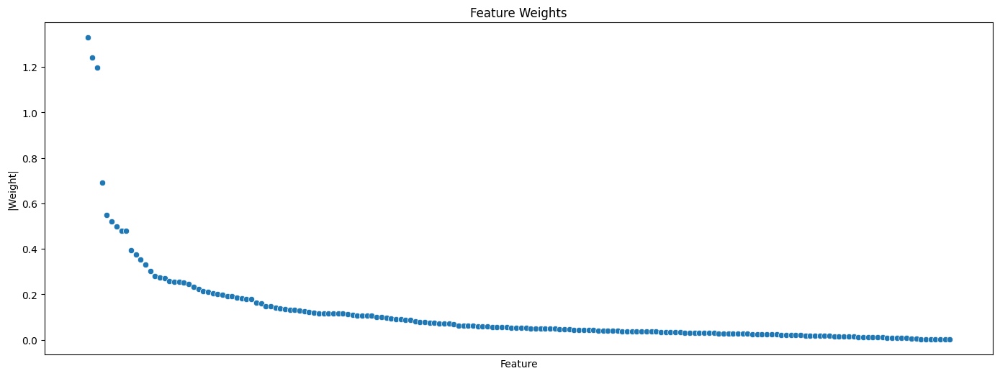

In [368]:
# Get Weights
feature_importances = pd.DataFrame({'Feature': X.columns, 'Weight': np.abs(svm.coef_[0])})
feature_importances = feature_importances.sort_values(by='Weight', ascending=False)

plt.figure(figsize=(17, 6))
sns.scatterplot(x='Feature', y='Weight', data=feature_importances)
plt.title('Feature Weights')
plt.ylabel('|Weight|')
plt.xticks([]) 
plt.show()

## Support Vector Machine

In [369]:
def specificity_score(y_true, y_pred):
    tn, fp, fn, tp = confusion_matrix(y_true, y_pred).ravel()
    specificity = tn / (tn+fp)
    return specificity

# Define the scoring metrics
scoring = {'accuracy': make_scorer(accuracy_score),                    # (TP + TN) / (TP + TN + FP + FN)
           'precision': make_scorer(precision_score, average='macro'), # TP / (TP + FP)
           'recall': make_scorer(recall_score, average='macro'),       # TP / (TP + FN)
           'specificity': make_scorer(specificity_score),              # TN / (TN + FP)
           'f1': make_scorer(f1_score, average='macro')}               # 2 * (precision * recall) / (precision + recall)

# Define the parameter range
param_grid = {'svm__C': [0.01, 0.1, 1, 10, 100],
              'pca__n_components': [180, int(180*.75), int(180*.5), int(180*.25)]}
           
# Declare the SVM model
pipeline = Pipeline([
    ('scaler', StandardScaler()), 
    ('pca', PCA()),
    ('svm', LinearSVC(dual='auto', random_state=64))
])

### Own scores

In [370]:
# Create a GridSearchCV object
grid_search = GridSearchCV(pipeline, param_grid, cv=5, scoring=scoring, return_train_score=True, refit='f1')

# Fit the GridSearchCV object to the data
grid_search.fit(X, y)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('pca', PCA()),
                                       ('svm',
                                        LinearSVC(dual='auto',
                                                  random_state=64))]),
             param_grid={'pca__n_components': [180, 135, 90, 45],
                         'svm__C': [0.01, 0.1, 1, 10, 100]},
             refit='f1', return_train_score=True,
             scoring={'accuracy': make_scorer(accuracy_score, response_method='predict'),
                      'f1': make_scorer(f1_score, response_method='predict', average=macro),
                      'precision': make_scorer(precision_score, response_method='predict', average=macro),
                      'recall': make_scorer(recall_score, response_method='predict', average=macro),
                      'specificity': make_scorer(specificity_score, response_method='predict')})

In [371]:
cv_results = pd.DataFrame(grid_search.cv_results_)
cv_results = cv_results[['param_pca__n_components', 'param_svm__C', 'mean_test_accuracy', 'mean_test_precision', 'mean_test_recall', 'mean_test_specificity', 'mean_test_f1']]
cv_results = cv_results.sort_values(by='mean_test_f1', ascending=False)
cv_results = cv_results.reset_index(drop=True)
cv_results.round(4)

,param_pca__n_components,param_svm__C,mean_test_accuracy,mean_test_precision,mean_test_recall,mean_test_specificity,mean_test_f1
0,180,10,0.8526,0.8653,0.8344,0.8943,0.8337
1,180,100,0.8525,0.8652,0.8343,0.8941,0.8336
2,180,1,0.8524,0.8653,0.8340,0.8943,0.8334
3,180,0.1,0.8516,0.8660,0.8327,0.8947,0.8322
4,180,0.01,0.8471,0.8647,0.8259,0.8955,0.8252
5,135,10,0.8324,0.8484,0.8101,0.8831,0.8085
6,135,1,0.8325,0.8486,0.8101,0.8835,0.8085
7,135,0.1,0.8321,0.8481,0.8099,0.8827,0.8083
8,135,100,0.8320,0.8477,0.8094,0.8835,0.8078
9,135,0.01,0.8291,0.8472,0.8064,0.8808,0.8042


In [372]:
cv_results.round(4).to_csv(f'{dataset_path}cv_results.csv', index=False, sep='&')

### python_speech_features scores

In [373]:
# Create a GridSearchCV object
psf_grid_search = GridSearchCV(pipeline, param_grid, cv=5, scoring=scoring, return_train_score=True, refit='f1')

# Fit the GridSearchCV object to the data
psf_grid_search.fit(psf_X, psf_Y)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('pca', PCA()),
                                       ('svm',
                                        LinearSVC(dual='auto',
                                                  random_state=64))]),
             param_grid={'pca__n_components': [180, 135, 90, 45],
                         'svm__C': [0.01, 0.1, 1, 10, 100]},
             refit='f1', return_train_score=True,
             scoring={'accuracy': make_scorer(accuracy_score, response_method='predict'),
                      'f1': make_scorer(f1_score, response_method='predict', average=macro),
                      'precision': make_scorer(precision_score, response_method='predict', average=macro),
                      'recall': make_scorer(recall_score, response_method='predict', average=macro),
                      'specificity': make_scorer(specificity_score, response_method='predict')})

In [374]:
# get mean scores for best estimator
psf_cv_results = pd.DataFrame(psf_grid_search.cv_results_)
psf_cv_results = psf_cv_results[['param_pca__n_components', 'param_svm__C', 'mean_test_accuracy', 'mean_test_precision', 'mean_test_recall', 'mean_test_specificity', 'mean_test_f1']]
psf_cv_results = psf_cv_results.sort_values(by='mean_test_f1', ascending=False)
psf_cv_results = psf_cv_results.reset_index(drop=True)
psf_cv_results.round(4)

,param_pca__n_components,param_svm__C,mean_test_accuracy,mean_test_precision,mean_test_recall,mean_test_specificity,mean_test_f1
0,180,10,0.8567,0.8643,0.8375,0.9005,0.8379
1,180,100,0.8567,0.8643,0.8375,0.9005,0.8379
2,180,1,0.8565,0.8646,0.8370,0.9011,0.8375
3,180,0.1,0.8562,0.8649,0.8360,0.9022,0.8366
4,180,0.01,0.8503,0.8638,0.8277,0.9017,0.8284
5,135,1,0.8252,0.8361,0.8046,0.8721,0.8017
6,135,10,0.8256,0.8374,0.8040,0.8748,0.8017
7,135,0.1,0.8248,0.8372,0.8031,0.8744,0.8007
8,135,100,0.8232,0.8329,0.8022,0.8709,0.7993
9,135,0.01,0.8212,0.8343,0.7997,0.8700,0.7964


In [375]:
psf_cv_results.round(4).to_csv(f'{dataset_path}psf_cv_results.csv', index=False, sep='&')

### librosa scores

In [376]:
# Create a GridSearchCV object
librosa_grid_search = GridSearchCV(pipeline, param_grid, cv=5, scoring=scoring, return_train_score=True, refit='f1')

# Fit the GridSearchCV object to the data
librosa_grid_search.fit(librosa_X, librosa_Y)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('pca', PCA()),
                                       ('svm',
                                        LinearSVC(dual='auto',
                                                  random_state=64))]),
             param_grid={'pca__n_components': [180, 135, 90, 45],
                         'svm__C': [0.01, 0.1, 1, 10, 100]},
             refit='f1', return_train_score=True,
             scoring={'accuracy': make_scorer(accuracy_score, response_method='predict'),
                      'f1': make_scorer(f1_score, response_method='predict', average=macro),
                      'precision': make_scorer(precision_score, response_method='predict', average=macro),
                      'recall': make_scorer(recall_score, response_method='predict', average=macro),
                      'specificity': make_scorer(specificity_score, response_method='predict')})

In [377]:
# get mean scores for best estimator
librosa_cv_results = pd.DataFrame(librosa_grid_search.cv_results_)
librosa_cv_results = librosa_cv_results[['param_pca__n_components', 'param_svm__C', 'mean_test_accuracy', 'mean_test_precision', 'mean_test_recall', 'mean_test_specificity', 'mean_test_f1']]
librosa_cv_results = librosa_cv_results.sort_values(by='mean_test_f1', ascending=False)
librosa_cv_results = librosa_cv_results.reset_index(drop=True)
librosa_cv_results.round(4)

,param_pca__n_components,param_svm__C,mean_test_accuracy,mean_test_precision,mean_test_recall,mean_test_specificity,mean_test_f1
0,180,10,0.8412,0.8514,0.8270,0.8734,0.8242
1,180,100,0.8412,0.8514,0.8270,0.8734,0.8242
2,180,1,0.8411,0.8514,0.8269,0.8733,0.8241
3,180,0.1,0.8403,0.8511,0.8262,0.8725,0.8232
4,180,0.01,0.8379,0.8519,0.8229,0.8721,0.8200
5,135,0.1,0.8127,0.8347,0.7960,0.8508,0.7911
6,135,100,0.8126,0.8343,0.7960,0.8504,0.7910
7,135,1,0.8122,0.8345,0.7955,0.8503,0.7905
8,135,0.01,0.8125,0.8358,0.7956,0.8508,0.7904
9,135,10,0.8118,0.8347,0.7953,0.8495,0.7901


In [378]:
librosa_cv_results.round(4).to_csv(f'{dataset_path}librosa_cv_results.csv', index=False, sep='&')

### Final scores

In [379]:
final_results = pd.concat([cv_results.head(1), psf_cv_results.head(1), librosa_cv_results.head(1)], axis=0)
# add names to the rows
final_results.index = ['Own MFCC', 'python_speech_features MFCC', 'librosa MFCC']
final_results.round(4)

,param_pca__n_components,param_svm__C,mean_test_accuracy,mean_test_precision,mean_test_recall,mean_test_specificity,mean_test_f1
Own MFCC,180,10,0.8526,0.8653,0.8344,0.8943,0.8337
python_speech_features MFCC,180,10,0.8567,0.8643,0.8375,0.9005,0.8379
librosa MFCC,180,10,0.8412,0.8514,0.8270,0.8734,0.8242
